# Tutorial - Identify faces and genders on a youtube trailer


**Objective of the tutorial**

In this tutorial, we are going to use Computer Vision to analyze the gender representation in a Youtube trailer. 
We will proceed as follows : 

1. Download a youtube trailer and extract frames from the trailer.
2. Use a face detection algorithm to extract the locations of faces in the frames extracted in step 1.
3. Use a gender classification algorithm to guess the genders of the faces detected in step 2.
4. Use the face representations obtained in step 2 to regroup faces by actor
5. Use a question-answering algorithm to ask questions about the movie trailer


In [1]:
#import necessary librairies
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from tqdm.auto import tqdm
import _pickle as pickle
from PIL import Image
import os

import requests
import cv2

%load_ext autoreload
%autoreload 2

import sys
sys.path.append("../../")

## Download the trailer from Youtube
We are going to use the get_youtube function inspired from https://huggingface.co/spaces/Karwasze/Whisper-ASR-youtube-subtitles/blob/main/app.py

In [2]:
from pytube import YouTube

def get_youtube(video_url):
    """Download youtube video from a given url and return the absolute path of the video"""
    yt = YouTube(video_url)
    abs_video_path = yt.streams.filter(progressive=True, file_extension='mp4').order_by('resolution').desc().first().download()
    
    return abs_video_path

For the purpose of this tutorial we are going to use the movie Les Tuche 4.

In [3]:
video_url = "https://www.youtube.com/watch?v=TCTtdSuj2eo&ab_channel=FilmsActu" #Tuche 4
video_path = get_youtube(video_url)

## Load video and extract frames

We use the Video class to extract the frames from the video at the rate of 1 frame per second. 

In [4]:
import bechdelai
from bechdelai.video.video import Video

video = Video(path = video_path,max_seconds = None,fps = 1)


  0%|          | 0/118 [00:00<?, ?it/s]

Video is finished


We have extracted 118 frames from the trailer. We can visualize them with the show_frames method.

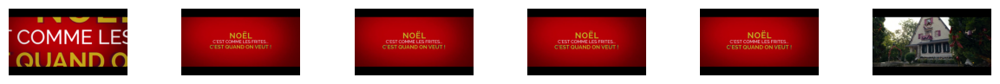

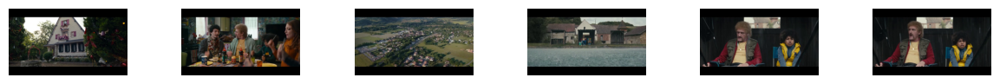

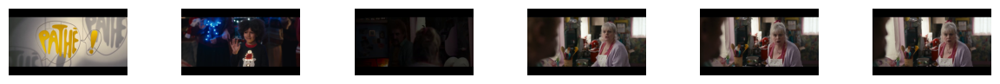

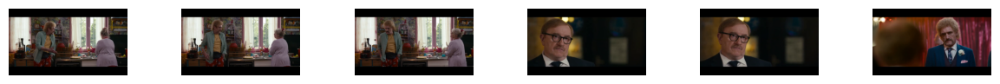

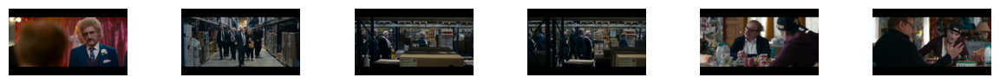

...

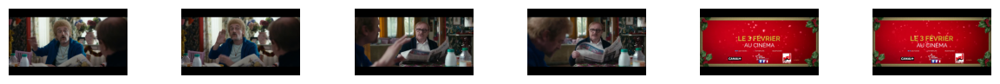

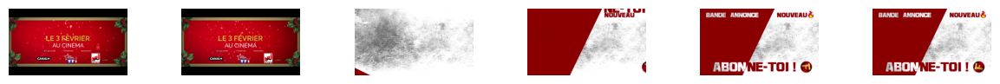

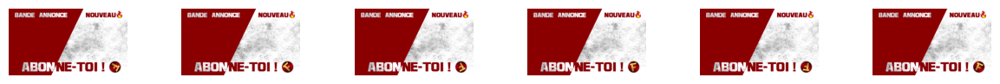

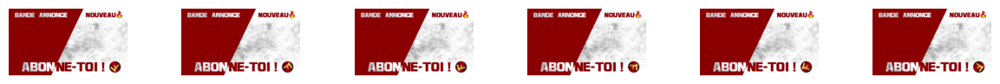

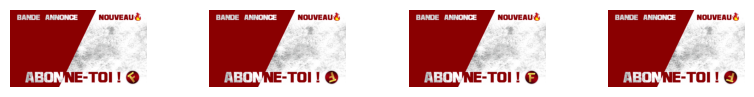

In [5]:
video.show_frames()

# Finding all faces and predicting gender

To analze the frames, we will need to use the Computer Vision tools developed in the library `bechdelai`. They use a combination of classical Computer Vision algorithms such as OpenCV with modern deep learning frameworks like CLIP.

In [6]:
from bechdelai.image.face_detection import FacesDetector
from bechdelai.image.gender_detection import GenderDetector

Gender detection works with the CLIP model used with zero-shot learning. Internal research has shown the BechdelAI team that the gender detection was a lot more accurate using zero-shot learning on modern Neural Network pre-trained model such as CLIP, than using the existing pre-trained model (like the ones in DeepFace, that is only a VGG-Face).

The CLIP model is retrieved from the Hugging Face hub https://huggingface.co/docs/transformers/model_doc/clip. The first time it will download the model and cache it to be faster the next time.

In [7]:
fd = FacesDetector()
gd = GenderDetector()

Loading CLIP model


## Analysis on one frame

If you are familiar with the tutorial "Analyzing gender representation in posters with Computer Vision" you can skip this part and go directly to the next section.
We select the eighth frame for our analysis.

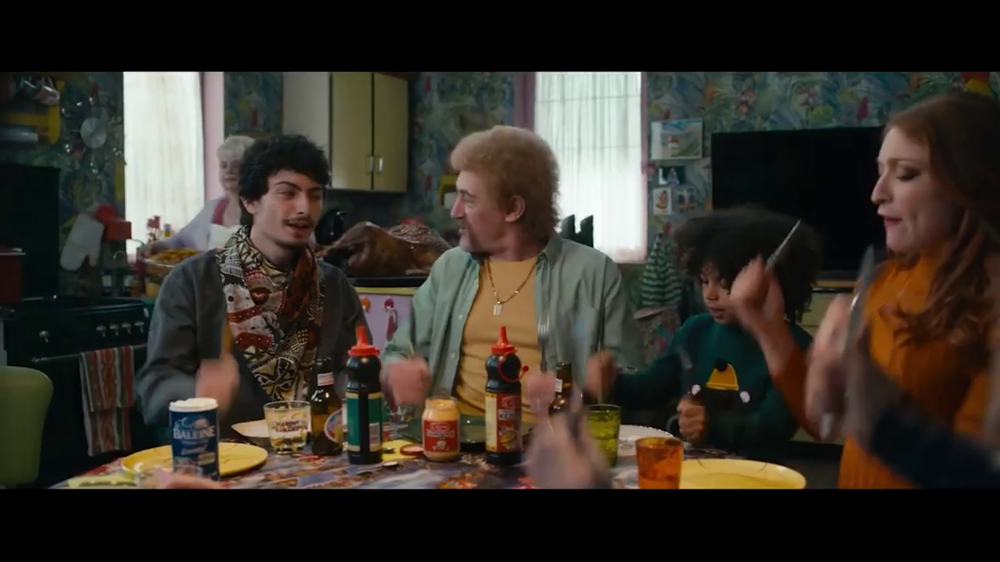

In [8]:
#chose the frame 
img = video.frames[7]
img

In [9]:
from bechdelai.image.utils import show_faces_on_image, show_all_faces

Let's first detect the faces on the frame.
We can chose the algorithm to identify the faces on the frame. The Retina Face algorithm provides higher accuracy but takes more time for detection (especially on CPU)

Note that the detect method returns the faces but also a dictionnary that provides details about the boundaries of the regions of interest (rois) that is the faces detected.

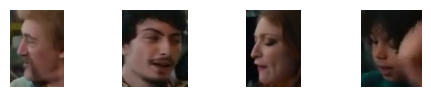

CPU times: total: 4.41 s
Wall time: 5.54 s


In [10]:
%%time
rois,faces = fd.detect(img.array,method = "retinaface",padding = 10)
show_all_faces(faces)

We can see 4 faces detected.
Now we can use the predict method to predict the gender corresponding to the faces.


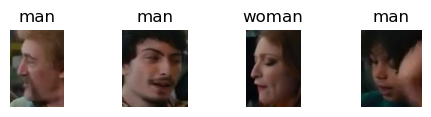

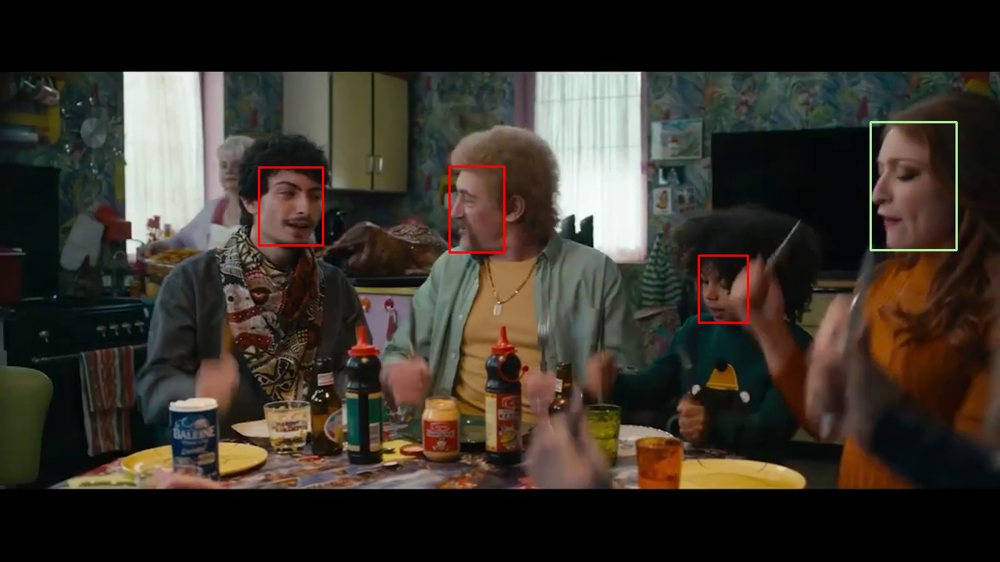

In [11]:
probas = gd.predict(faces,img = img.array)
show_all_faces(faces,titles = probas["gender"])

show_faces_on_image(img.array,rois,genders = probas["gender"])

The probas table provides the probability for each class and the area of the region of interest (i.e the face)

In [12]:
probas

,man,woman,diff,gender,area,area_percentage_relative,area_percentage_total
0,0.990690,0.009310,0.981380,man,11700,0.206502,0.012695
1,0.991209,0.008791,0.982419,man,12240,0.216033,0.013281
2,0.210460,0.789540,0.579079,woman,23920,0.422182,0.025955
3,0.971359,0.028641,0.942717,man,8798,0.155283,0.009546


We can use the analyse_probas method to have the statistics about the gender gaps in the frame.

In [13]:
results,metrics = gd.analyze_probas(probas)

We can analyse the results as follows : 

- On this frame male faces take 57% of the facial areas against 42% for female faces.<br>
- The number of actors is 3 times the number of actress (ratio_count : 3.0x 🧑)
- The space occupied by men faces is 40 % more than the space the space occupied by women faces. (ratio area : 1.4 x 🧑)<br>
- area_gap : the space occupied by women faces represent 73% of the space occupied by men faces. (area_gap)

In [14]:
display(results)
metrics

,space_occupied,count
gender,,
man,0.577818,3
woman,0.422182,1


{'women_area': 0.4221822161036394,
 'men_area': 0.5778177838963606,
 'n_women': 1,
 'n_men': 3,
 'ratio_count': '3.0x 🧑',
 'ratio_area': '1.4x 🧑',
 'n_characters': 4,
 'area_gap': 0.7306493982527948,
 'count_gap': 0.3333333333333333}

## Analysis on all frames of the trailer

We will now detect faces and predict genders on all the 118 frames extracted in the video trail (see step 1).

  0%|          | 0/118 [00:00<?, ?it/s]

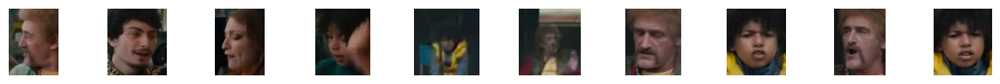

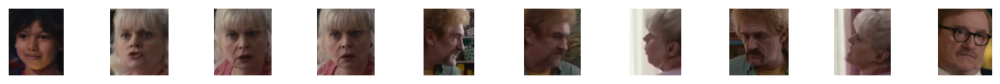

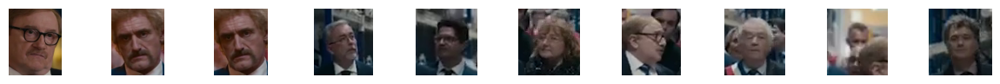

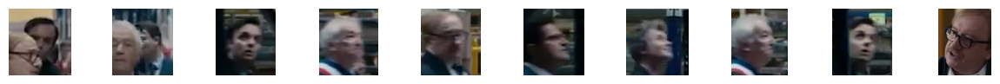

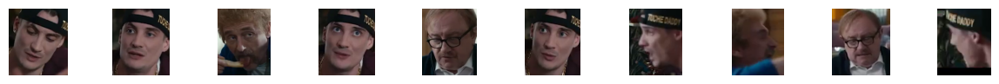

...

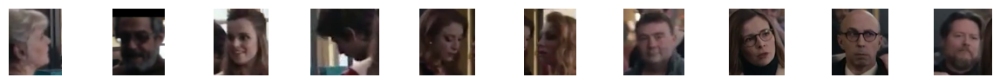

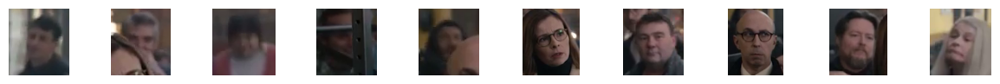

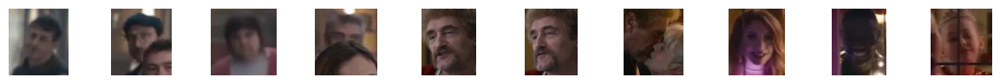

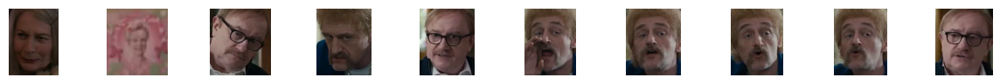

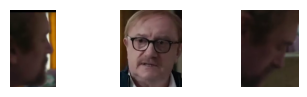

In [15]:
#detect faces 
faces,faces_metadata, rois_list = fd.detect_many(video,method = "retinaface",padding = 20)
show_all_faces(faces)

rois_list provides details on the boundaries of the regions of interest (i.e facial areas) for each frame.

faces_metadata is a dataframe that helps us identify:
- the frames on which the algorithm has detected faces and
- the number of faces detected on these frames

In [16]:
display(faces_metadata.head())
print(f"There are {len(faces_metadata['frame_id'].unique())} frames with faces detected")
print(f"There are {len(faces_metadata.index)} faces detected in theses frames")

,frame_id,face_id
0,7,0
1,7,1
2,7,2
3,7,3
4,9,0


There are 75 frames with faces detected
There are 153 faces detected in theses frames


We can see below that the maximum number of faces detected on a frame is 9.

In [17]:
faces_metadata[faces_metadata['face_id']==faces_metadata['face_id'].max()]

,frame_id,face_id
31,25,8
124,74,8
133,75,8


We can now predict the genders of the faces that have been detected.

In [18]:
#predict genders
probas,annotations, annotations_dict = gd.predict(faces,faces_metadata)

The probas dataframe provides us with the probability of each class and details on the space occupied by the faces.

In [19]:
probas.head()

,man,woman,diff,gender,area,area_percentage_relative
0,0.984179,0.015821,0.968358,man,16500,0.004962
1,0.980200,0.019800,0.960400,man,17080,0.005136
2,0.306388,0.693612,0.387225,woman,30600,0.009202
3,0.939879,0.060121,0.879758,man,12978,0.003903
4,0.903135,0.096865,0.806270,man,2703,0.000813


Among the faces detected by the algorithm, male faces take 88.85 % of the space, female faces only 10.21%. <br>
The gender is not determined for less than one percent of the faces. 

In [20]:
print("men face area: ", probas.loc[probas["gender"]=="man", "area_percentage_relative"].sum())
print("women face area: ",probas.loc[probas["gender"]=="woman", "area_percentage_relative"].sum())
print("unknown face area: ",probas.loc[probas["gender"]=="unknown", "area_percentage_relative"].sum())

men face area:  0.8885516770175874
women face area:  0.10206573345987799
unknown face area:  0.009382589522534453


Let's inspect the faces and genders detected visually.<br>
To make our life easier let's create a dataframe that gathers all the information from the probas and faces_metada.

In [21]:
probas['faces']=faces
probas_metadata=pd.concat([probas,faces_metadata], axis=1)

In [22]:
#add gender and frame number as titles
titles=[i+'\n' + str(j) for i,j in  probas_metadata[["gender","frame_id"]].values]

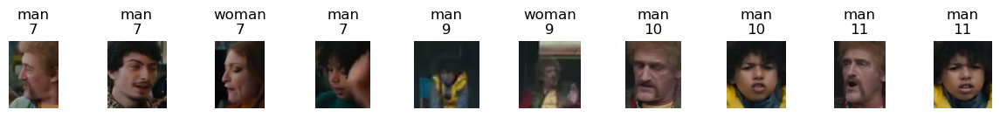

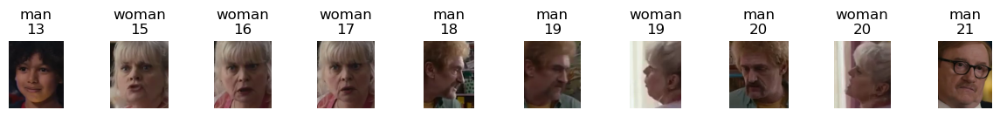

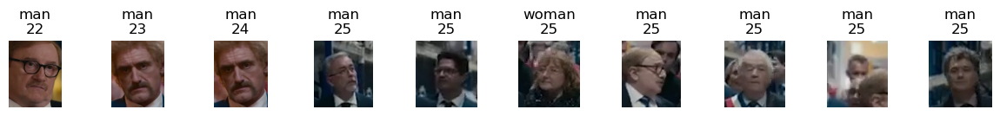

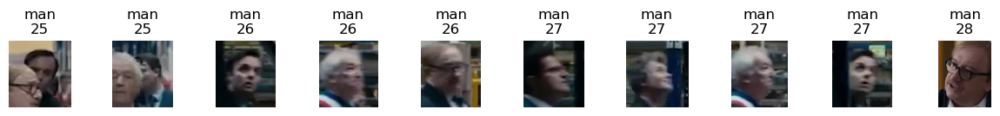

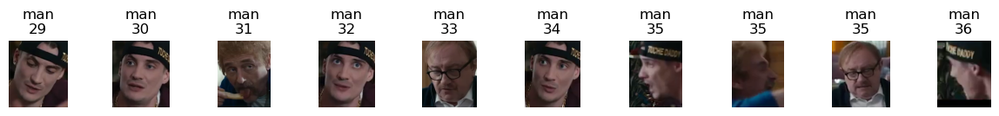

...

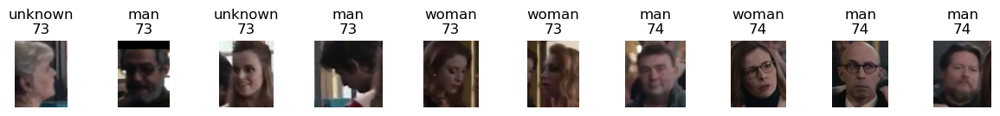

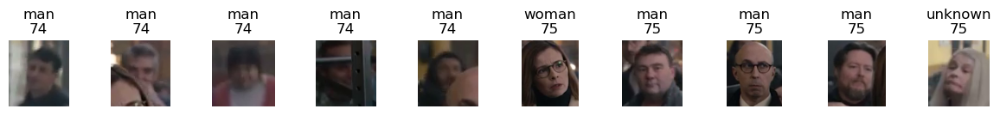

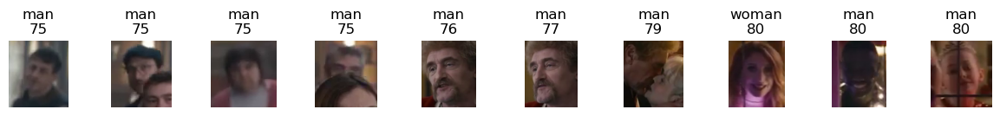

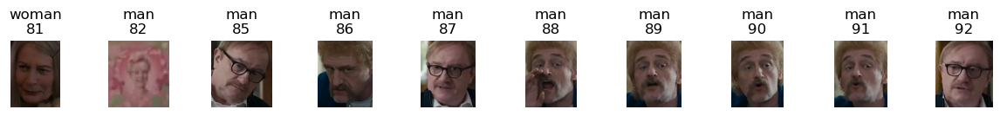

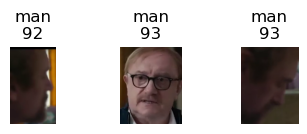

In [23]:
show_all_faces(faces,titles = titles)

We can see that there are some faces that seem to have detected on pictures in frame 37, we may want to correct these and only take into account the faces of actors.

annotation is a dataframe that provides us the count of faces detected by gender on each frame.<br>
annotation_dict is providing us with the same information in the form of a dictionnary. We can use the annotation_dict to annotate the video and identify the frame with errors that we may correct manually.

In [24]:
annotations.head()

gender,man,unknown,woman
frame_id,,,
7,3.0,0.0,1.0
9,1.0,0.0,1.0
10,2.0,0.0,0.0
11,2.0,0.0,0.0
13,1.0,0.0,0.0


In [25]:
#annotate video
video.reset_annotations()
video.annotate(annotations_dict)

We can now replay the trailer and see the annotations on top of each frame.
We can see that the frame_id 37 contains faces that are actually pictures on the wall 

In [26]:
video.replay()

interactive(children=(Play(value=0, description='Press play', interval=500, max=117), Output()), _dom_classes=…

IntSlider(value=0, max=117)

# Regroup faces per actor

Our objective now is to identify the faces that the algorithm has detected, more specifically, we want to make the distinction between the main characters in the movie and the extras.

1) Try to cluster images by comparing pairs of embeddings

In [27]:
from bechdelai.image.face_detection import HiddenPrints
from deepface import DeepFace

In [28]:
man_faces=probas.loc[probas['gender']=='man','faces']
woman_faces=probas.loc[probas['gender']=='woman','faces']

In [251]:
embeddings = []

for face in tqdm(man_faces.to_list()):
    with HiddenPrints():
        emb = DeepFace.represent(np.array(face),model_name = "ArcFace",enforce_detection=False)
    embeddings.append(np.array(emb[0]['embedding']))
    
embeddings = np.stack(embeddings)

  0%|          | 0/130 [00:00<?, ?it/s]

In [64]:
len(man_faces)

130

In [59]:
# from deepface.commons import distance as dst

# distance = dst.findEuclideanDistance(embeddings[0], embeddings[1])
# threshold = dst.findThreshold('ArcFace', 'euclidean')

# if distance <= threshold:
#     identified = True
# else:
#     identified = False

In [99]:
embeddings.shape

(130, 512)

In [252]:
counter=0
clusters=[]
while embeddings.shape[0]>0 and counter<=len(man_faces):
    a_list=[1]
    for i in range(0,embeddings.shape[0]-1):
        distance = dst.findEuclideanDistance(embeddings[0], embeddings[i+1])
        threshold = dst.findThreshold('ArcFace', 'euclidean')
        if distance <= threshold:
            a_list.append(1)
        else:
            a_list.append(0)
        
    clusters.append(embeddings[np.array(a_list)==1])
    embeddings=embeddings[np.array(a_list)==0]
    print("shape embed", embeddings.shape)
    counter+=1
    a_list=[0]*(i+1)+[1]
    print("list2:",len(a_list))
    print("counter",counter)
    

shape embed (112, 512)
list2: 130
counter 1
shape embed (97, 512)
list2: 112
counter 2
shape embed (47, 512)
list2: 97
counter 3
shape embed (44, 512)
list2: 47
counter 4
shape embed (35, 512)
list2: 44
counter 5
shape embed (17, 512)
list2: 35
counter 6
shape embed (13, 512)
list2: 17
counter 7
shape embed (10, 512)
list2: 13
counter 8
shape embed (9, 512)
list2: 10
counter 9
shape embed (7, 512)
list2: 9
counter 10
shape embed (6, 512)
list2: 7
counter 11
shape embed (4, 512)
list2: 6
counter 12
shape embed (2, 512)
list2: 4
counter 13
shape embed (1, 512)
list2: 2
counter 14
shape embed (0, 512)
list2: 2
counter 15


In [253]:
len(clusters)

15

In [209]:
list(np.array(man_faces)[np.where((embeddings == clusters[0][1]).all(axis=1))[0]])

[<PIL.Image.Image image mode=RGB size=103x126>]

In [215]:
faces_by_clusters_dic={}
for i in range(len(clusters)):
    face_list=[]
    for j in range(clusters[i].shape[0]): 
        face_list.extend(list(np.array(man_faces)[np.where((embeddings == clusters[i][j]).all(axis=1))[0]]))
    faces_by_clusters_dic[i]=face_list

In [216]:
faces_by_clusters_dic[0]

[<PIL.Image.Image image mode=RGB size=110x150>,
 <PIL.Image.Image image mode=RGB size=103x126>,
 <PIL.Image.Image image mode=RGB size=66x72>,
 <PIL.Image.Image image mode=RGB size=74x84>,
 <PIL.Image.Image image mode=RGB size=68x72>,
 <PIL.Image.Image image mode=RGB size=67x72>,
 <PIL.Image.Image image mode=RGB size=59x65>,
 <PIL.Image.Image image mode=RGB size=77x87>,
 <PIL.Image.Image image mode=RGB size=129x165>,
 <PIL.Image.Image image mode=RGB size=109x127>,
 <PIL.Image.Image image mode=RGB size=82x98>,
 <PIL.Image.Image image mode=RGB size=57x68>,
 <PIL.Image.Image image mode=RGB size=58x65>,
 <PIL.Image.Image image mode=RGB size=151x197>,
 <PIL.Image.Image image mode=RGB size=128x139>,
 <PIL.Image.Image image mode=RGB size=125x142>,
 <PIL.Image.Image image mode=RGB size=165x213>,
 <PIL.Image.Image image mode=RGB size=176x195>]

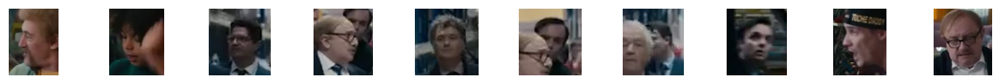

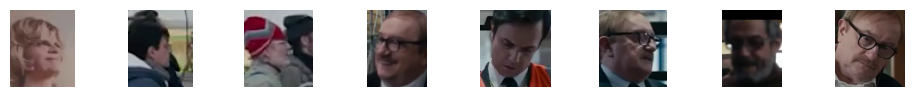

In [217]:
show_all_faces(faces_by_clusters_dic[0])

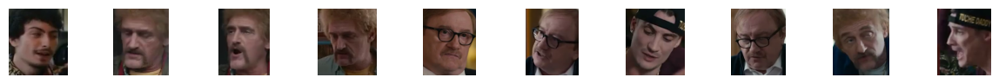

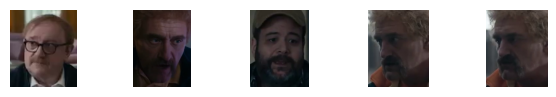

In [218]:
show_all_faces(faces_by_clusters_dic[1])

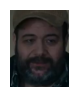

In [243]:
show_all_faces(faces_by_clusters_dic[8])

2. Try clustering algorithms

In [28]:
man_faces=probas.loc[probas['gender']=='man','faces']
woman_faces=probas.loc[probas['gender']=='woman','faces']

In [251]:
embeddings = []

for face in tqdm(man_faces.to_list()):
    with HiddenPrints():
        emb = DeepFace.represent(np.array(face),model_name = "ArcFace",enforce_detection=False)
    embeddings.append(np.array(emb[0]['embedding']))
    
embeddings = np.stack(embeddings)

  0%|          | 0/130 [00:00<?, ?it/s]

In [64]:
len(man_faces)

130

In [121]:
%%time
embeddings2D = fd.reduce_embeddings(embeddings)

CPU times: total: 2.11 s
Wall time: 1.89 s



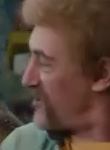
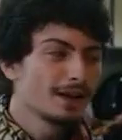
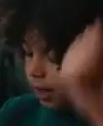
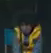
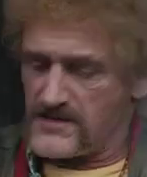
...
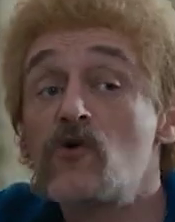
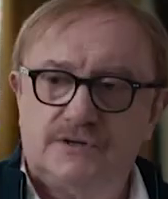
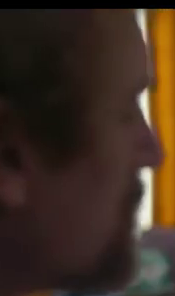
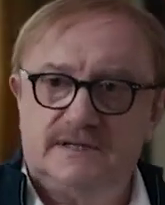
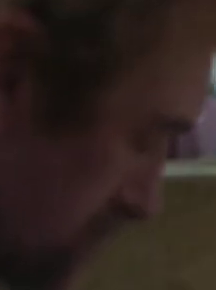

In [123]:
fd.show_embeddings2D(embeddings2D,man_faces.to_list())

In [124]:
from sklearn.preprocessing import StandardScaler

In [125]:
embeddings = StandardScaler().fit_transform(embeddings)

In [102]:
from sklearn.decomposition import PCA

In [136]:
pca = PCA(n_components=100)
embeddings_pca=pca.fit_transform(embeddings)

In [137]:
from sklearn.cluster import KMeans

In [146]:
kmean = KMeans(n_clusters=10, random_state=22)
kmean_clusters = kmean.fit_predict(embeddings)

In [150]:
titles=["frame"+str(i)+"\n face"+str(j) for i, j in probas_metadata.loc[probas_metadata['gender']=='man', ['frame_id','face_id']].values]

Cluster 0


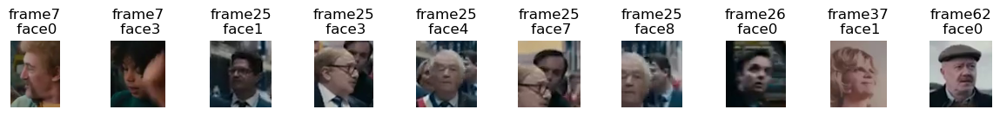

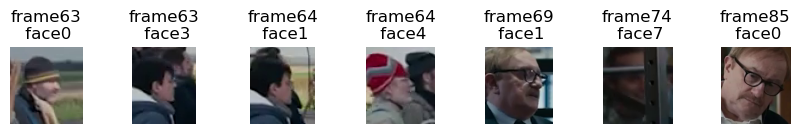

Cluster 1


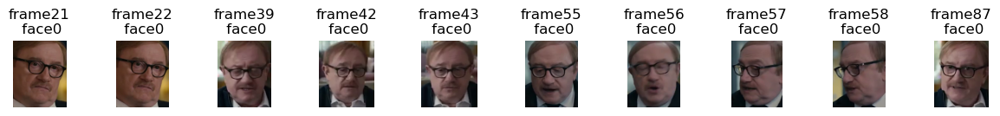

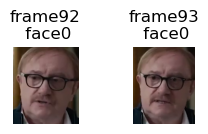

Cluster 2


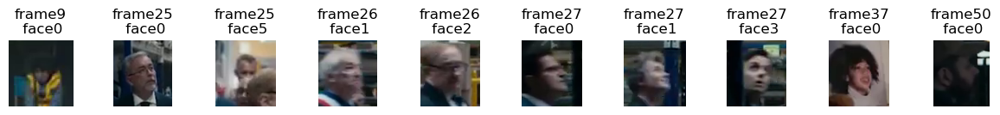

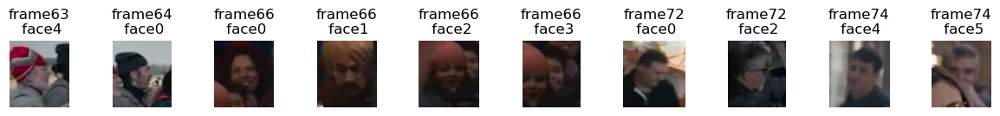

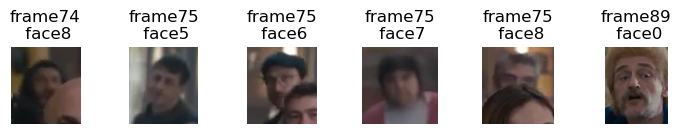

Cluster 3


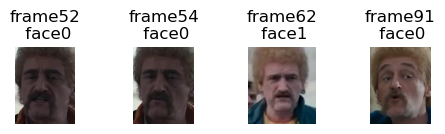

Cluster 4


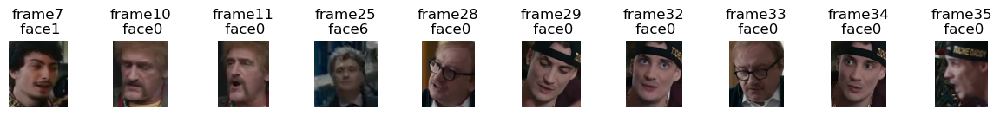

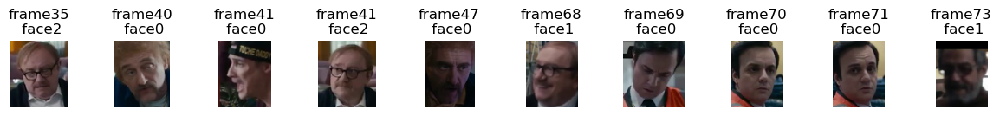

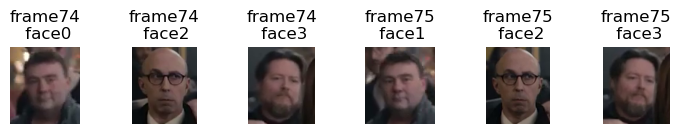

Cluster 5


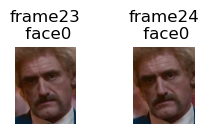

Cluster 6


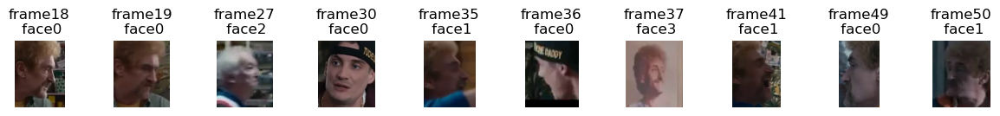

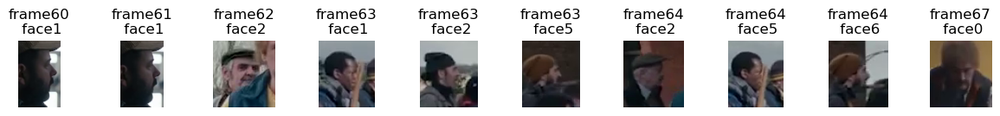

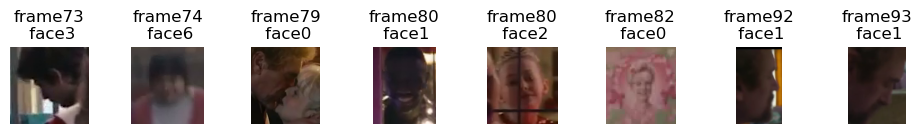

Cluster 7


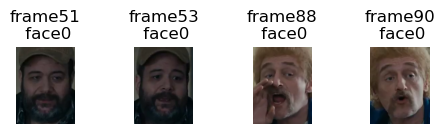

Cluster 8


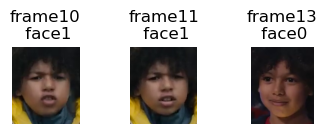

Cluster 9


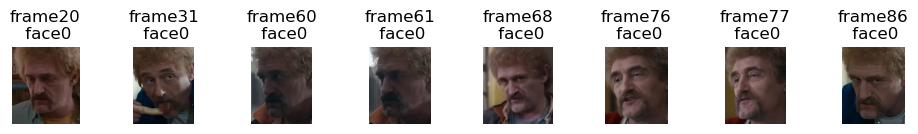

In [152]:
fd.show_faces_by_cluster(man_faces.to_list(),kmean_clusters, titles=titles)

# Work in progress...

## Analyzing frames with ViLT

In [153]:
from bechdelai.image.vilt import ViLT

In [154]:
vilt = ViLT()

Loading ViLT model


Downloading:   0%|          | 0.00/251 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/320 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/232k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/466k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/112 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/136k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/470M [00:00<?, ?B/s]

In [155]:
len(video.frames)

118

In [26]:
preds_i,probas_i = vilt.predict(video.frames[10],["How many women ?","How many men ?"])

In [27]:
preds_i

[   rank answer     proba
 0     0      2  0.637255
 1     1      1  0.352919
 2     2      3  0.006494
 3     3      0  0.001811
 4     4      4  0.000498,
    rank answer     proba
 0     0      0  0.677432
 1     1      1  0.290764
 2     2      2  0.029414
 3     3      3  0.000882
 4     4     no  0.000413]

In [8]:
%%time
preds,probas = vilt.predict_many(video.frames,["How many women ?","How many men ?"])

  0%|          | 0/118 [00:00<?, ?it/s]

CPU times: total: 24min 36s
Wall time: 9min 3s


In [38]:
final_preds = preds.query("proba > 0.9").query("rank==0")
final_preds = final_preds.pivot(index = "image_id",columns = "question",values = "answer").fillna("0")
final_preds

question,How many men ?,How many women ?
image_id,,
1,0,0
2,0,0
3,0,0
4,0,0
5,0,0
...,...,...
110,0,0
112,0,0
113,0,0


In [39]:
video.annotate(final_preds.to_dict(orient = "index"))
video.replay()

interactive(children=(Play(value=0, description='Press play', interval=500, max=117), Output()), _dom_classes=…

IntSlider(value=0, max=117)

In [13]:
from bechdelai.utils.timeline import convert_to_timeline,fn_timeline,fn_create_sequence_id

In [18]:
women = final_preds["How many women ?"].reset_index()
women.columns = ["frame_id","pred"]
women["sequence_id"] = fn_create_sequence_id(women["pred"])

In [19]:
x = convert_to_timeline(women,description_col = "pred",show = False)

In [37]:
import plotly.express as px

fig = px.timeline(x,
                  x_start = "start",
                  x_end = "end",
                  y = "pred",
                  color = "pred",
#                   range_x = [0,max(x["end"])],
                  color_discrete_sequence = px.colors.qualitative.Alphabet
                 )

# fig.update_traces(mode="markers+lines", hovertemplate=None)
fig.update_layout(hovermode="x")

fig


# Scene detection & change detection
- https://www.amazon.science/blog/automatically-identifying-scene-boundaries-in-movies-and-tv-shows
- https://github.com/wanglimin/MRCNN-Scene-Recognition
- https://scenedetect.com/projects/Manual/en/latest/api.html#quickstart
- https://scenedetect.com/projects/Manual/en/latest/api.html#example
- https://paperswithcode.com/task/scene-change-detection

In [6]:
from bechdelai.video.utils import get_frame_from_cap
from bechdelai.video.utils import extract_frames_from_video
from bechdelai.video.utils import extract_frames_from_scenes
from bechdelai.video.utils import show_frames

In [7]:
from bechdelai.video.video import Video

In [125]:
%%time
video = Video(path = video_path,detect_scenes = True)

Detected: 61 | Progress: : 2817frames [00:08, 326.47frames/s]

Detected 62 scenes in the video


  0%|          | 0/62 [00:00<?, ?it/s]

CPU times: total: 41.6 s
Wall time: 14.2 s


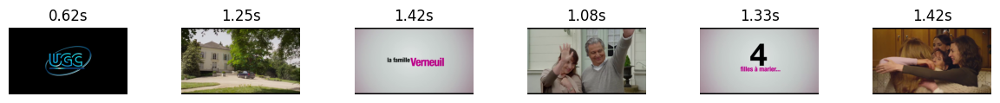

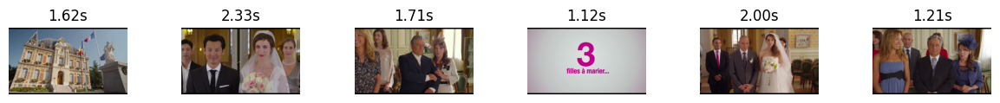

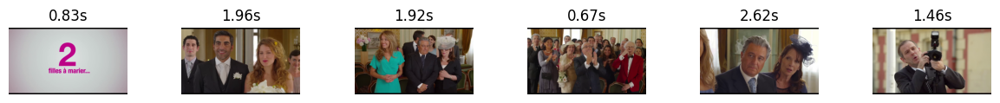

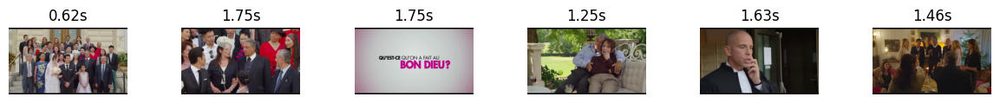

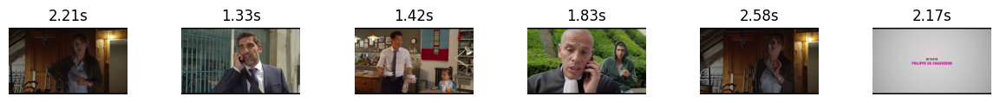

...

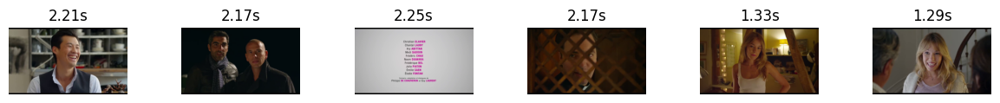

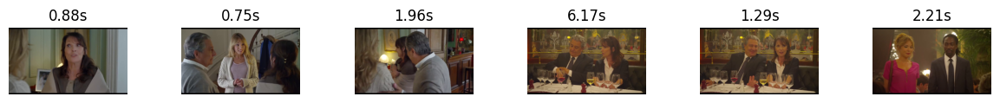

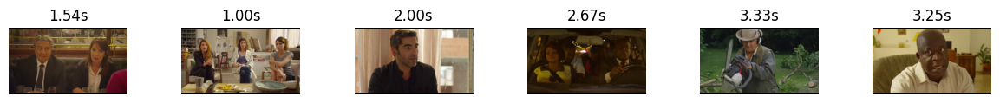

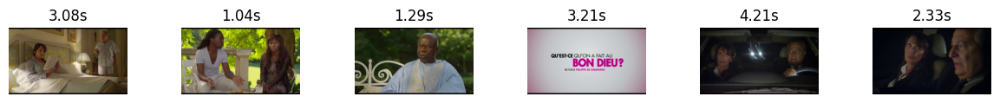

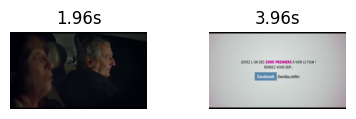

In [126]:
video.show_frames(titles = video.scenes_durations)

In [83]:
from bechdelai.image.face_detection import FacesDetector
from bechdelai.image.gender_detection import GenderDetector
from bechdelai.image.utils import show_all_faces,show_faces_on_image

fd = FacesDetector()
gd = GenderDetector()

Loading CLIP model


  0%|          | 0/62 [00:00<?, ?it/s]

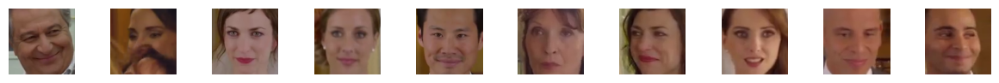

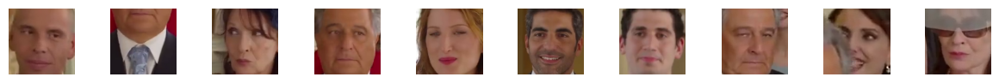

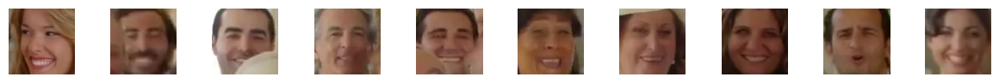

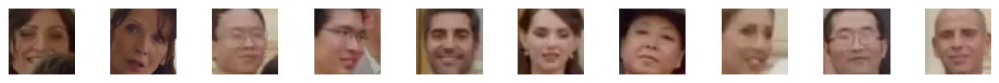

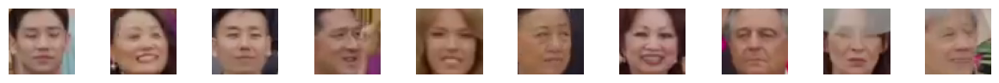

...

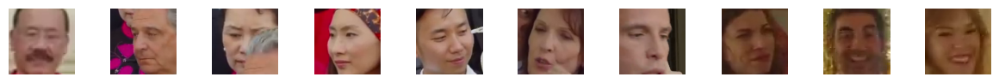

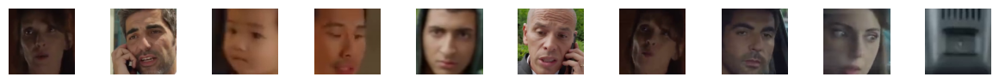

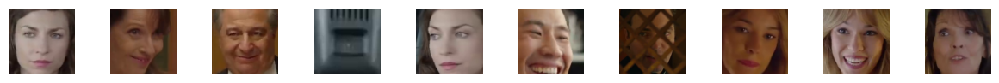

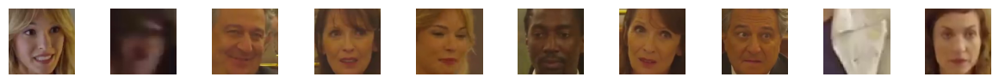

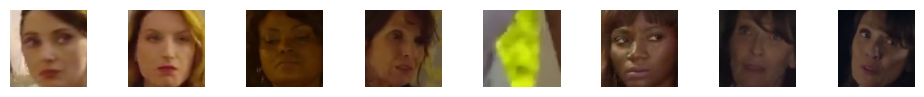

In [127]:
faces,faces_metadata,rois_list = fd.detect_many(video,method = "opencv",padding = 0)
show_all_faces(faces)

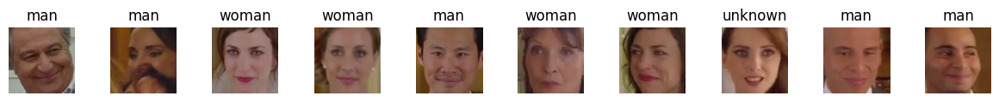

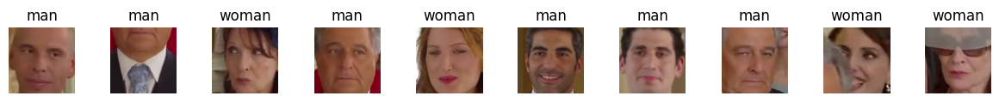

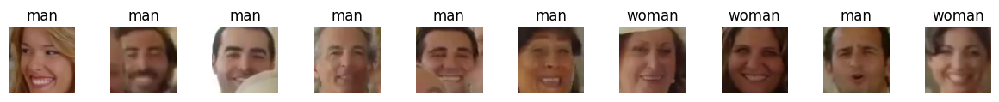

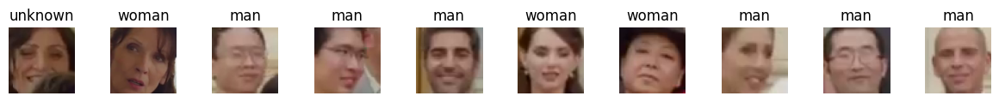

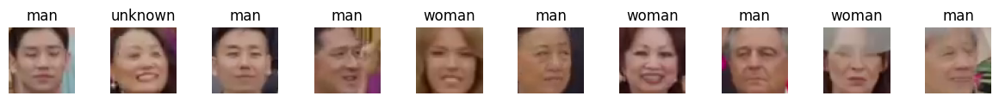

...

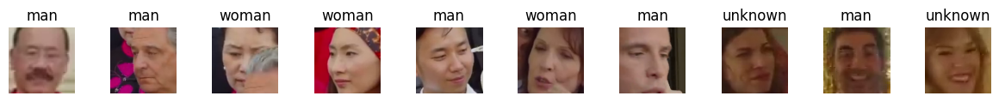

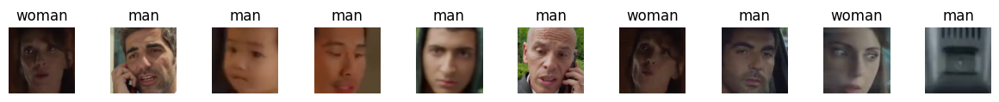

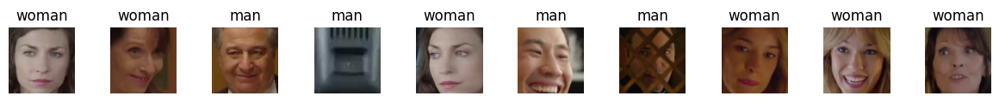

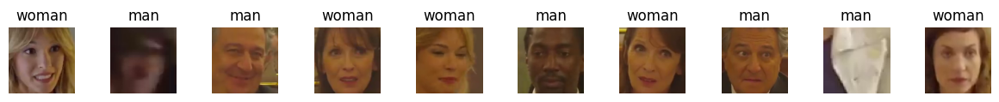

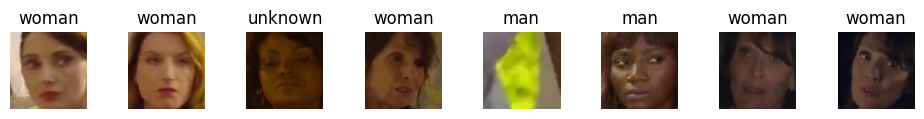

In [128]:
probas,annotations_data,annotations_dict = gd.predict(faces,faces_metadata)
video.reset_annotations()
video.annotate(annotations_dict)
show_all_faces(faces,titles = probas["gender"].tolist())

In [129]:
timeline_gender = (annotations_data
 .reindex(labels = range(len(video.frames)))
 .fillna(0.0)
 .assign(duration = lambda _ : [x.duration for x in video.scenes])
 .assign(end = lambda x : x["duration"].cumsum())
 .assign(start = lambda x : x["end"].shift(1).fillna(0.0))
 .melt(ignore_index = False,id_vars = ["duration","start","end"])
 .assign(start_date = lambda x : pd.to_datetime("2022-01-01") + x["start"].map(lambda y : pd.Timedelta(seconds = y)))
 .assign(end_date = lambda x : pd.to_datetime("2022-01-01") + x["end"].map(lambda y : pd.Timedelta(seconds = y)))
)

In [130]:
import plotly.express as px

In [133]:
px.timeline(
    timeline_gender.query("gender!='unknown'"),x_start = "start_date",x_end = "end_date",color = "value",y = "gender",
    color_continuous_scale= "Blues",color_continuous_midpoint=5
)

In [86]:
video.add_rois(rois_list)

In [87]:
video.replay()

interactive(children=(Play(value=0, description='Press play', interval=500, max=66), Output()), _dom_classes=(…

IntSlider(value=0, max=66)

In [90]:
probas

,man,woman,diff,gender,area,area_percentage_relative
0,0.981608,0.018392,0.963217,man,10404,0.009337
1,0.992388,0.007612,0.984776,man,18496,0.016599
2,0.996047,0.003953,0.992095,man,12544,0.011257
3,0.885506,0.114494,0.771013,man,47961,0.043042
4,0.979703,0.020297,0.959405,man,21025,0.018868
5,0.552241,0.447759,0.104481,woman,22201,0.019924
6,0.453428,0.546572,0.093144,unknown,25281,0.022688
7,0.993312,0.006688,0.986624,man,12769,0.011459
8,0.967119,0.032881,0.934239,man,31329,0.028116
9,0.220504,0.779496,0.558992,woman,33489,0.030054


In [88]:
probas

,man,woman,diff,gender,area,area_percentage_relative
0,0.981608,0.018392,0.963217,man,10404,0.009337
1,0.992388,0.007612,0.984776,man,18496,0.016599
2,0.996047,0.003953,0.992095,man,12544,0.011257
3,0.885506,0.114494,0.771013,man,47961,0.043042
4,0.979703,0.020297,0.959405,man,21025,0.018868
5,0.552241,0.447759,0.104481,woman,22201,0.019924
6,0.453428,0.546572,0.093144,unknown,25281,0.022688
7,0.993312,0.006688,0.986624,man,12769,0.011459
8,0.967119,0.032881,0.934239,man,31329,0.028116
9,0.220504,0.779496,0.558992,woman,33489,0.030054


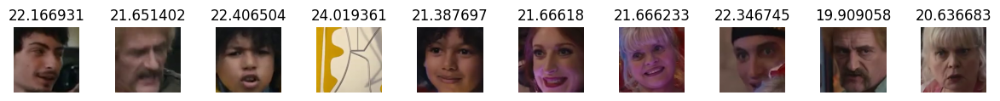

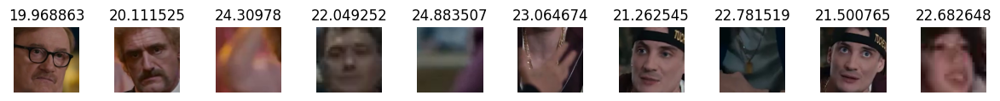

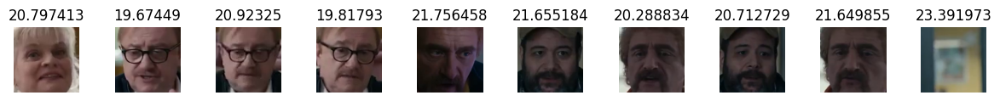

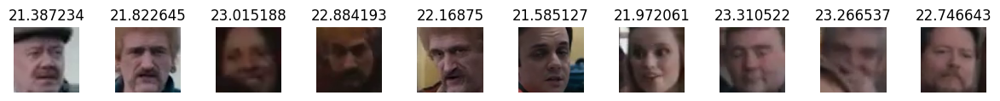

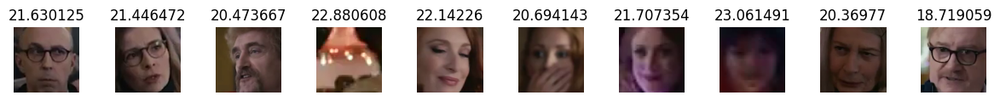

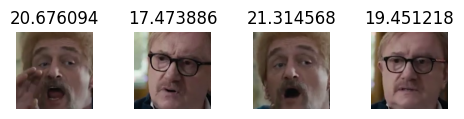

In [61]:
fd.show_all_faces(faces,titles = logits["background"])

In [44]:
gd.model.predict(faces[2])

(         man      woman       face
 0  26.297098  20.767666  24.128033,
         man     woman      face
 0  0.894252  0.003549  0.102199)

In [31]:
# video.resize(width = 400)

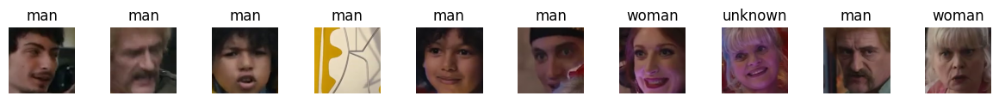

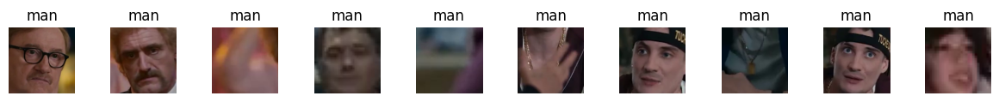

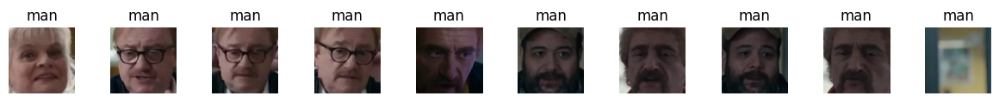

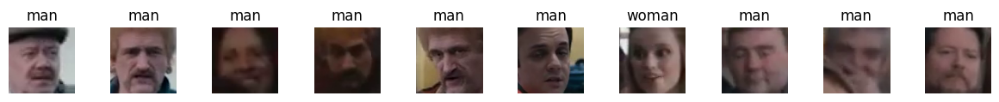

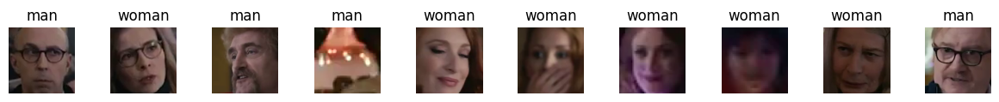

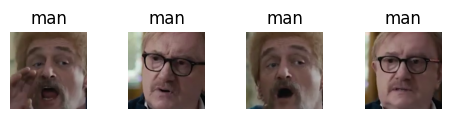

In [34]:
probas,annotations = gd.predict(faces,faces_metadata)
video.reset_annotations()
video.annotate(annotations)
fd.show_all_faces(faces,titles = probas["gender"].tolist())

In [11]:
# # video = open_video(video_path)
# for i, scene in enumerate(scene_list):
#     print("-"*100)
#     print(f"Scene {i} - {scene}")
#     frame_start,frame_end = scene[0].get_frames(),scene[1].get_frames()
#     _,frames = extract_frames_from_video(cap,fps = 1,frame_start = frame_start,frame_end = frame_end,max_seconds = None,progress = False)
#     show_frames(frames)

In [130]:
# for i, scene in enumerate(scene_list):
#     print('Scene %2d: Start %s / Frame %d, End %s / Frame %d' % (
#         i+1,
#         scene[0].get_timecode(), scene[0].get_frames(),
#         scene[1].get_timecode(), scene[1].get_frames(),))

# Software
- https://pythonvideoannotator.readthedocs.io/en/master/index.html
- https://www.viametoolkit.org/
- https://github.com/dsgou/annotator
- https://github.com/heartexlabs/labelImg
- https://github.com/opencv/cvat

En particulier tester https://github.com/video-annotator/pythonvideoannotator

# Tester un software qui existe déjà ?
- https://www.tator.io/